<a href="https://colab.research.google.com/github/Neelesh-Jaiswal/Mechanisms-of-Action-MoA-Prediction/blob/master/MoA_1_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
import tensorflow as tf
print("GPU is", "available" if tf.config.experimental.list_physical_devices("GPU") else "NOT AVAILABLE")

GPU is available


In [6]:
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install gputil
!pip install psutil
!pip install humanize
import psutil
import humanize
import os
import GPUtil as GPU
GPUs = GPU.getGPUs()
gpu = GPUs[0]
def printm():
 process = psutil.Process(os.getpid())
 print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
 print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
printm()

  Created wheel for gputil: filename=GPUtil-1.4.0-cp36-none-any.whl size=7411 sha256=f93495d9e0b8c6b4d1d41726c5cfbe475e7cea691204bc5c517058a2262c6ea0
  Stored in directory: /root/.cache/pip/wheels/3d/77/07/80562de4bb0786e5ea186911a2c831fdd0018bda69beab71fd
Successfully built gputil
Gen RAM Free: 12.7 GB  | Proc size: 390.8 MB
GPU RAM Free: 11430MB | Used: 11MB | Util   0% | Total 11441MB


In [7]:
import os
from google.colab import files
files.upload()
os.system("mkdir -p ~/.kaggle")
os.system("cp kaggle.json ~/.kaggle/")
os.system("chmod 600 ~/.kaggle/kaggle.json")

Saving kaggle.json to kaggle.json


0

In [8]:
!kaggle competitions download -c lish-moa

  0% 0.00/257k [00:00<?, ?B/s]
100% 257k/257k [00:00<00:00, 62.7MB/s]
  0% 0.00/9.16M [00:00<?, ?B/s]
100% 9.16M/9.16M [00:00<00:00, 84.2MB/s]
  0% 0.00/233k [00:00<?, ?B/s]
100% 233k/233k [00:00<00:00, 72.1MB/s]
  0% 0.00/38.9k [00:00<?, ?B/s]
100% 38.9k/38.9k [00:00<00:00, 38.2MB/s]
 93% 51.0M/54.8M [00:00<00:00, 64.4MB/s]
100% 54.8M/54.8M [00:00<00:00, 112MB/s] 


In [9]:
!unzip sample_submission.csv.zip

Archive:  sample_submission.csv.zip
  inflating: sample_submission.csv   


In [10]:
!unzip test_features.csv.zip

Archive:  test_features.csv.zip
  inflating: test_features.csv       


In [11]:
!unzip train_features.csv.zip

Archive:  train_features.csv.zip
  inflating: train_features.csv      


In [12]:
!unzip train_targets_nonscored.csv.zip

Archive:  train_targets_nonscored.csv.zip
  inflating: train_targets_nonscored.csv  


In [13]:
!unzip train_targets_scored.csv.zip

Archive:  train_targets_scored.csv.zip
  inflating: train_targets_scored.csv  


In [14]:
import pandas as pd
pd.options.display.max_rows = None
pd.options.display.max_columns = None

In [15]:
df = pd.read_csv('train_features.csv')
df.head()

,sig_id,cp_type,cp_time,cp_dose,g-0,g-1,g-2,g-3,g-4,g-5,g-6,g-7,g-8,g-9,g-10,g-11,g-12,g-13,g-14,g-15,g-16,g-17,g-18,g-19,g-20,g-21,g-22,g-23,g-24,g-25,g-26,g-27,g-28,g-29,g-30,g-31,g-32,g-33,g-34,g-35,g-36,g-37,g-38,g-39,g-40,g-41,g-42,g-43,g-44,g-45,g-46,g-47,g-48,g-49,g-50,g-51,g-52,g-53,g-54,g-55,g-56,g-57,g-58,g-59,g-60,g-61,g-62,g-63,g-64,g-65,g-66,g-67,g-68,g-69,g-70,g-71,g-72,g-73,g-74,g-75,g-76,g-77,g-78,g-79,g-80,g-81,g-82,g-83,g-84,g-85,g-86,g-87,g-88,g-89,g-90,g-91,g-92,g-93,g-94,g-95,g-96,g-97,g-98,g-99,g-100,g-101,g-102,g-103,g-104,g-105,g-106,g-107,g-108,g-109,g-110,g-111,g-112,g-113,g-114,g-115,g-116,g-117,g-118,g-119,g-120,g-121,g-122,g-123,g-124,g-125,g-126,g-127,g-128,g-129,g-130,g-131,g-132,g-133,g-134,g-135,g-136,g-137,g-138,g-139,g-140,g-141,g-142,g-143,g-144,g-145,g-146,g-147,g-148,g-149,g-150,g-151,g-152,g-153,g-154,g-155,g-156,g-157,g-158,g-159,g-160,g-161,g-162,g-163,g-164,g-165,g-166,g-167,g-168,g-169,g-170,g-171,g-172,g-173,g-174,g-175,g-176,g-177,g-178,g-179,g-180,g-181,g-182,g-183,g-184,g-185,g-186,g-187,g-188,g-189,g-190,g-191,g-192,g-193,g-194,g-195,g-196,g-197,g-198,g-199,g-200,g-201,g-202,g-203,g-204,g-205,g-206,g-207,g-208,g-209,g-210,g-211,g-212,g-213,g-214,g-215,g-216,g-217,g-218,g-219,g-220,g-221,g-222,g-223,g-224,g-225,g-226,g-227,g-228,g-229,g-230,g-231,g-232,g-233,g-234,g-235,g-236,g-237,g-238,g-239,g-240,g-241,g-242,g-243,g-244,g-245,g-246,g-247,g-248,g-249,g-250,g-251,g-252,g-253,g-254,g-255,g-256,g-257,g-258,g-259,g-260,g-261,g-262,g-263,g-264,g-265,g-266,g-267,g-268,g-269,g-270,g-271,g-272,g-273,g-274,g-275,g-276,g-277,g-278,g-279,g-280,g-281,g-282,g-283,g-284,g-285,g-286,g-287,g-288,g-289,g-290,g-291,g-292,g-293,g-294,g-295,g-296,g-297,g-298,g-299,g-300,g-301,g-302,g-303,g-304,g-305,g-306,g-307,g-308,g-309,g-310,g-311,g-312,g-313,g-314,g-315,g-316,g-317,g-318,g-319,g-320,g-321,g-322,g-323,g-324,g-325,g-326,g-327,g-328,g-329,g-330,g-331,g-332,g-333,g-334,g-335,g-336,g-337,g-338,g-339,g-340,g-341,g-342,g-343,g-344,g-345,g-346,g-347,g-348,g-349,g-350,g-351,g-352,g-353,g-354,g-355,g-356,g-357,g-358,g-359,g-360,g-361,g-362,g-363,g-364,g-365,g-366,g-367,g-368,g-369,g-370,g-371,g-372,g-373,g-374,g-375,g-376,g-377,g-378,g-379,g-380,g-381,g-382,g-383,g-384,g-385,g-386,g-387,g-388,g-389,g-390,g-391,g-392,g-393,g-394,g-395,g-396,g-397,g-398,g-399,g-400,g-401,g-402,g-403,g-404,g-405,g-406,g-407,g-408,g-409,g-410,g-411,g-412,g-413,g-414,g-415,g-416,g-417,g-418,g-419,g-420,g-421,g-422,g-423,g-424,g-425,g-426,g-427,g-428,g-429,g-430,g-431,g-432,g-433,g-434,g-435,g-436,g-437,g-438,g-439,g-440,g-441,g-442,g-443,g-444,g-445,g-446,g-447,g-448,g-449,g-450,g-451,g-452,g-453,g-454,g-455,g-456,g-457,g-458,g-459,g-460,g-461,g-462,g-463,g-464,g-465,g-466,g-467,g-468,g-469,g-470,g-471,g-472,g-473,g-474,g-475,g-476,g-477,g-478,g-479,g-480,g-481,g-482,g-483,g-484,g-485,g-486,g-487,g-488,g-489,g-490,g-491,g-492,g-493,g-494,g-495,g-496,g-497,g-498,g-499,g-500,g-501,g-502,g-503,g-504,g-505,g-506,g-507,g-508,g-509,g-510,g-511,g-512,g-513,g-514,g-515,g-516,g-517,g-518,g-519,g-520,g-521,g-522,g-523,g-524,g-525,g-526,g-527,g-528,g-529,g-530,g-531,g-532,g-533,g-534,g-535,g-536,g-537,g-538,g-539,g-540,g-541,g-542,g-543,g-544,g-545,g-546,g-547,g-548,g-549,g-550,g-551,g-552,g-553,g-554,g-555,g-556,g-557,g-558,g-559,g-560,g-561,g-562,g-563,g-564,g-565,g-566,g-567,g-568,g-569,g-570,g-571,g-572,g-573,g-574,g-575,g-576,g-577,g-578,g-579,g-580,g-581,g-582,g-583,g-584,g-585,g-586,g-587,g-588,g-589,g-590,g-591,g-592,g-593,g-594,g-595,g-596,g-597,g-598,g-599,g-600,g-601,g-602,g-603,g-604,g-605,g-606,g-607,g-608,g-609,g-610,g-611,g-612,g-613,g-614,g-615,g-616,g-617,g-618,g-619,g-620,g-621,g-622,g-623,g-624,g-625,g-626,g-627,g-628,g-629,g-630,g-631,g-632,g-633,g-634,g-635,g-636,g-637,g-638,g-639,g-640,g-641,g-642,g-643,g-644,g-645,g-646,g-647,g-648,g-649,g-650,g-651,g-652,g-653,g-654,g-655,g-656,g-657,g-658,g-659,g-660,g-661,g-662,g-663,g-664,g-665,g-666,g-667,g-668,g-669,g-670,g-671,g-672,g-673,g-674,g-675,g-676,g-677,g-678,g-67

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23814 entries, 0 to 23813
Columns: 876 entries, sig_id to c-99
dtypes: float64(872), int64(1), object(3)
memory usage: 159.2+ MB


In [17]:
df.describe(include = 'all')

sig_id cp_type       cp_time cp_dose           g-0  \
count          23814   23814  23814.000000   23814  23814.000000   
unique         23814       2           NaN       2           NaN   
top     id_a8957c3d7  trt_cp           NaN      D1           NaN   
freq               1   21948           NaN   12147           NaN   
mean             NaN     NaN     48.020156     NaN      0.248366   
std              NaN     NaN     19.402807     NaN      1.393399   
min              NaN     NaN     24.000000     NaN     -5.513000   
25%              NaN     NaN     24.000000     NaN     -0.473075   
50%              NaN     NaN     48.000000     NaN     -0.008850   
75%              NaN     NaN     72.000000     NaN      0.525700   
max              NaN     NaN     72.000000     NaN     10.000000   

                 g-1           g-2           g-3           g-4           g-5  \
count   23814.000000  23814.000000  23814.000000  23814.000000  23814.000000   
unique           NaN           NaN           NaN           NaN           NaN   
top              NaN           NaN           NaN           NaN           NaN   
freq             NaN           NaN           NaN           NaN           NaN   
mean       -0.095684      0.152253      0.081971      0.057347     -0.138836   
std         0.812363      1.035731      0.950012      1.032091      1.179388   
min        -5.737000     -9.104000     -5.998000     -6.369000    -10.000000   
25%        -0.562200     -0.437750     -0.429575     -0.470925     -0.602225   
50%        -0.046600      0.075200      0.008050     -0.026900     -0.015650   
75%         0.403075      0.663925      0.463400      0.465375      0.510425   
max         5.039000      8.257000     10.000000     10.000000      7.282000   

                 g-6           g-7           g-8           g-9          g-10  \
count   23814.000000  23814.000000  23814.000000  23814.000000  23814.000000   
unique           NaN           NaN           NaN           NaN           NaN   
top              NaN           NaN           NaN           NaN           NaN   
freq             NaN           NaN           NaN           NaN           NaN   
mean        0.035961     -0.202651     -0.190083      0.119905     -0.123321   
std         0.882395      1.125494      1.749885      1.087180      1.291501   
min       -10.000000    -10.000000    -10.000000     -8.337000    -10.000000   
25%        -0.493900     -0.525175     -0.511675     -0.360200     -0.511475   
50%        -0.000650     -0.017900      0.010000      0.160450      0.038550   
75%         0.528725      0.411900      0.549225      0.697775      0.525400   
max         7.333000      5.473000      8.887000      6.433000     10.000000   

                g-11          g-12          g-13          g-14          g-15  \
count   23814.000000  23814.000000  23814.000000  23814.000000  23814.000000   
unique           NaN           NaN           NaN           NaN           NaN   
top              NaN           NaN           NaN           NaN           NaN   
freq             NaN           NaN           NaN           NaN           NaN   
mean        0.182307      0.143203      0.209402     -0.173884     -0.024432   
std         1.253604      1.234590      1.273068      1.247178      0.659839   
min        -5.870000     -8.587000     -5.018000    -10.000000    -10.000000   
25%        -0.489675     -0.447500     -0.481200     -0.607975     -0.404150   
50%         0.013800      0.060250      0.009800     -0.030100      0.000000   
75%         0.575275      0.604450      0.575825      0.457975      0.382475   
max        10.000000     10.000000     10.000000     10.000000      4.134000   

                g-16          g-17          g-18          g-19          g-20  \
count   23814.000000  23814.000000  23814.000000  23814.000000  23814.000000   
unique           NaN           NaN           NaN           NaN           NaN   
top              NaN           NaN           NaN           NaN           N

### g- signify gene expression data
### c- signify cell viability data
### g-0 to g-771 all continuous variable
### c-0 to c-99 all continuous variable
### sig_id, cp_type, cp_time,cp_dose - catergorical varaibles

In [17]:
#!pip install pandas-profiling==2.7.1

     |████████████████████████████████| 256kB 4.6MB/s 
     |████████████████████████████████| 604kB 14.5MB/s 
     |████████████████████████████████| 61kB 8.2MB/s 
     |████████████████████████████████| 3.1MB 18.7MB/s 
     |████████████████████████████████| 71kB 10.2MB/s 
     |████████████████████████████████| 71kB 9.6MB/s 
     |████████████████████████████████| 296kB 58.7MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=562385b5a9449092e66fe837d85c7bd15c6a449347280c0088c84bf98a2025b7
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Created wheel for imagehash: filename=ImageHash-4.1.0-py2.py3-none-any.whl size=291991 sha256=fd8facb281921eef3dc4aa14d5df4b12c28244e6e3978502d35bf7068ef5b30f
  Stored in directory: /root/.cache/pip/wheels/07/1c/dc/6831446f09feb8cc199ec73a0f2f0703253f6ae013a22f4be9
Successfully built htmlmin imagehash
  Found existing installation: tqdm 4.41.1
    U

In [15]:
df['cp_type'].value_counts()

trt_cp         21948
ctl_vehicle     1866
Name: cp_type, dtype: int64

In [18]:
#dropping the id column
df.drop('sig_id',axis = 'columns', inplace = True)
df.head(2)

,cp_type,cp_time,cp_dose,g-0,g-1,g-2,g-3,g-4,g-5,g-6,g-7,g-8,g-9,g-10,g-11,g-12,g-13,g-14,g-15,g-16,g-17,g-18,g-19,g-20,g-21,g-22,g-23,g-24,g-25,g-26,g-27,g-28,g-29,g-30,g-31,g-32,g-33,g-34,g-35,g-36,g-37,g-38,g-39,g-40,g-41,g-42,g-43,g-44,g-45,g-46,g-47,g-48,g-49,g-50,g-51,g-52,g-53,g-54,g-55,g-56,g-57,g-58,g-59,g-60,g-61,g-62,g-63,g-64,g-65,g-66,g-67,g-68,g-69,g-70,g-71,g-72,g-73,g-74,g-75,g-76,g-77,g-78,g-79,g-80,g-81,g-82,g-83,g-84,g-85,g-86,g-87,g-88,g-89,g-90,g-91,g-92,g-93,g-94,g-95,g-96,g-97,g-98,g-99,g-100,g-101,g-102,g-103,g-104,g-105,g-106,g-107,g-108,g-109,g-110,g-111,g-112,g-113,g-114,g-115,g-116,g-117,g-118,g-119,g-120,g-121,g-122,g-123,g-124,g-125,g-126,g-127,g-128,g-129,g-130,g-131,g-132,g-133,g-134,g-135,g-136,g-137,g-138,g-139,g-140,g-141,g-142,g-143,g-144,g-145,g-146,g-147,g-148,g-149,g-150,g-151,g-152,g-153,g-154,g-155,g-156,g-157,g-158,g-159,g-160,g-161,g-162,g-163,g-164,g-165,g-166,g-167,g-168,g-169,g-170,g-171,g-172,g-173,g-174,g-175,g-176,g-177,g-178,g-179,g-180,g-181,g-182,g-183,g-184,g-185,g-186,g-187,g-188,g-189,g-190,g-191,g-192,g-193,g-194,g-195,g-196,g-197,g-198,g-199,g-200,g-201,g-202,g-203,g-204,g-205,g-206,g-207,g-208,g-209,g-210,g-211,g-212,g-213,g-214,g-215,g-216,g-217,g-218,g-219,g-220,g-221,g-222,g-223,g-224,g-225,g-226,g-227,g-228,g-229,g-230,g-231,g-232,g-233,g-234,g-235,g-236,g-237,g-238,g-239,g-240,g-241,g-242,g-243,g-244,g-245,g-246,g-247,g-248,g-249,g-250,g-251,g-252,g-253,g-254,g-255,g-256,g-257,g-258,g-259,g-260,g-261,g-262,g-263,g-264,g-265,g-266,g-267,g-268,g-269,g-270,g-271,g-272,g-273,g-274,g-275,g-276,g-277,g-278,g-279,g-280,g-281,g-282,g-283,g-284,g-285,g-286,g-287,g-288,g-289,g-290,g-291,g-292,g-293,g-294,g-295,g-296,g-297,g-298,g-299,g-300,g-301,g-302,g-303,g-304,g-305,g-306,g-307,g-308,g-309,g-310,g-311,g-312,g-313,g-314,g-315,g-316,g-317,g-318,g-319,g-320,g-321,g-322,g-323,g-324,g-325,g-326,g-327,g-328,g-329,g-330,g-331,g-332,g-333,g-334,g-335,g-336,g-337,g-338,g-339,g-340,g-341,g-342,g-343,g-344,g-345,g-346,g-347,g-348,g-349,g-350,g-351,g-352,g-353,g-354,g-355,g-356,g-357,g-358,g-359,g-360,g-361,g-362,g-363,g-364,g-365,g-366,g-367,g-368,g-369,g-370,g-371,g-372,g-373,g-374,g-375,g-376,g-377,g-378,g-379,g-380,g-381,g-382,g-383,g-384,g-385,g-386,g-387,g-388,g-389,g-390,g-391,g-392,g-393,g-394,g-395,g-396,g-397,g-398,g-399,g-400,g-401,g-402,g-403,g-404,g-405,g-406,g-407,g-408,g-409,g-410,g-411,g-412,g-413,g-414,g-415,g-416,g-417,g-418,g-419,g-420,g-421,g-422,g-423,g-424,g-425,g-426,g-427,g-428,g-429,g-430,g-431,g-432,g-433,g-434,g-435,g-436,g-437,g-438,g-439,g-440,g-441,g-442,g-443,g-444,g-445,g-446,g-447,g-448,g-449,g-450,g-451,g-452,g-453,g-454,g-455,g-456,g-457,g-458,g-459,g-460,g-461,g-462,g-463,g-464,g-465,g-466,g-467,g-468,g-469,g-470,g-471,g-472,g-473,g-474,g-475,g-476,g-477,g-478,g-479,g-480,g-481,g-482,g-483,g-484,g-485,g-486,g-487,g-488,g-489,g-490,g-491,g-492,g-493,g-494,g-495,g-496,g-497,g-498,g-499,g-500,g-501,g-502,g-503,g-504,g-505,g-506,g-507,g-508,g-509,g-510,g-511,g-512,g-513,g-514,g-515,g-516,g-517,g-518,g-519,g-520,g-521,g-522,g-523,g-524,g-525,g-526,g-527,g-528,g-529,g-530,g-531,g-532,g-533,g-534,g-535,g-536,g-537,g-538,g-539,g-540,g-541,g-542,g-543,g-544,g-545,g-546,g-547,g-548,g-549,g-550,g-551,g-552,g-553,g-554,g-555,g-556,g-557,g-558,g-559,g-560,g-561,g-562,g-563,g-564,g-565,g-566,g-567,g-568,g-569,g-570,g-571,g-572,g-573,g-574,g-575,g-576,g-577,g-578,g-579,g-580,g-581,g-582,g-583,g-584,g-585,g-586,g-587,g-588,g-589,g-590,g-591,g-592,g-593,g-594,g-595,g-596,g-597,g-598,g-599,g-600,g-601,g-602,g-603,g-604,g-605,g-606,g-607,g-608,g-609,g-610,g-611,g-612,g-613,g-614,g-615,g-616,g-617,g-618,g-619,g-620,g-621,g-622,g-623,g-624,g-625,g-626,g-627,g-628,g-629,g-630,g-631,g-632,g-633,g-634,g-635,g-636,g-637,g-638,g-639,g-640,g-641,g-642,g-643,g-644,g-645,g-646,g-647,g-648,g-649,g-650,g-651,g-652,g-653,g-654,g-655,g-656,g-657,g-658,g-659,g-660,g-661,g-662,g-663,g-664,g-665,g-666,g-667,g-668,g-669,g-670,g-671,g-672,g-673,g-674,g-675,g-676,g-677,g-678,g-679,g-680

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [9]:
df.corr()

cp_time       g-0       g-1       g-2       g-3       g-4       g-5  \
cp_time  1.000000  0.007610  0.043335 -0.162238 -0.031226  0.027241 -0.081324   
g-0      0.007610  1.000000  0.086032  0.176188  0.011266  0.403153 -0.165478   
g-1      0.043335  0.086032  1.000000 -0.054518 -0.027855  0.193647 -0.151590   
g-2     -0.162238  0.176188 -0.054518  1.000000  0.042633  0.013968  0.018516   
g-3     -0.031226  0.011266 -0.027855  0.042633  1.000000 -0.033039  0.042231   
g-4      0.027241  0.403153  0.193647  0.013968 -0.033039  1.000000 -0.057449   
g-5     -0.081324 -0.165478 -0.151590  0.018516  0.042231 -0.057449  1.000000   
g-6     -0.030058  0.238348 -0.122541  0.015190 -0.043177  0.206405  0.083620   
g-7      0.003499 -0.374451  0.144537 -0.144205 -0.175692 -0.032748  0.102345   
g-8     -0.024291 -0.604212 -0.009973 -0.128029 -0.086167 -0.474828  0.073885   
g-9     -0.027571 -0.428779 -0.047558 -0.081332 -0.014052 -0.274167  0.126561   
g-10    -0.011929 -0.547606 -0.009051 -0.105050 -0.074101 -0.458021  0.038743   
g-11     0.051251  0.219762  0.161274  0.011198  0.181024  0.116467 -0.171709   
g-12    -0.058311 -0.199453  0.037178 -0.063501  0.030539 -0.207078 -0.000393   
g-13    -0.013073  0.472223 -0.009256  0.082011  0.192727  0.210440 -0.112423   
g-14    -0.023851 -0.346179  0.002632 -0.082204  0.128792 -0.307280  0.073760   
g-15     0.021028 -0.201323 -0.070193 -0.059607 -0.045688  0.019531  0.037763   
g-16    -0.007433 -0.513026 -0.063414 -0.137811  0.033974 -0.275700  0.221227   
g-17    -0.028415 -0.433536 -0.000944 -0.085491 -0.070920 -0.422889  0.033641   
g-18     0.018688 -0.002073 -0.023748  0.053335  0.237669 -0.012207  0.041073   
g-19     0.037969 -0.074622 -0.034714  0.028813  0.112392 -0.088152  0.134431   
g-20     0.000098 -0.468599 -0.131031 -0.061160  0.027867 -0.311798  0.136226   
g-21     0.031892  0.052445  0.196596 -0.129131 -0.167263  0.286106  0.042455   
g-22     0.004133  0.022269 -0.061441 -0.007426  0.197013 -0.055368  0.095901   
g-23    -0.061059 -0.076298  0.090620 -0.034230 -0.049480 -0.113396 -0.000709   
g-24    -0.062770 -0.337522 -0.004299 -0.128312 -0.113336 -0.120743  0.120697   
g-25    -0.051570 -0.235191 -0.032600 -0.067363  0.175615 -0.233682  0.082212   
g-26    -0.046168 -0.422814 -0.019435 -0.126554  0.111355 -0.340708  0.058257   
g-27     0.043406  0.148432  0.015661  0.036984  0.007168  0.070292 -0.106304   
g-28     0.017017 -0.471092 -0.098907 -0.129481 -0.022381 -0.360274  0.137596   
g-29    -0.022081 -0.296871 -0.091071 -0.017941 -0.128269 -0.225461  0.171353   
g-30    -0.055457 -0.528327 -0.053331 -0.152288 -0.042827 -0.402256  0.136856   
g-31     0.052436  0.558136 -0.049514  0.172191  0.098416  0.324362 -0.133521   
g-32    -0.008367 -0.133229  0.187382 -0.100086 -0.091962  0.091731  0.025275   
g-33     0.083075 -0.155987 -0.091232 -0.033010 -0.083806 -0.052787 -0.070144   
g-34    -0.087673 -0.120247  0.045417 -0.015481  0.184985 -0.073490  0.058305   
g-35     0.015208  0.327593  0.044373  0.001098 -0.070933  0.195062 -0.108843   
g-36     0.073013 -0.147800 -0.077671 -0.020374 -0.317859 -0.124394 -0.034259   
g-37     0.005969 -0.591868 -0.005265 -0.157977 -0.228039 -0.277002  0.142193   
g-38     0.055692  0.602623 -0.042213  0.169464  0.084346  0.285256 -0.189048   
g-39     0.011744  0.450769  0.050546  0.144449  0.054827  0.300517 -0.097622   
g-40    -0.082116 -0.432426  0.000655 -0.080201  0.114685 -0.309149  0.208673   
g-41    -0.043708 -0.499815 -0.110238 -0.109646 -0.047136 -0.373390  0.206885   
g-42     0.016129 -0.203828  0.133896 -0.121433 -0.010941  0.071462  0.120727   
g-43     0.017836  0.021582  0.161186 -0.086435 -0.168398  0.185361 -0.031065   
g-44    -0.017701 -0.023423 -0.092498  0.021241 -0.001770 -0.105936 -0.047988   
g-45     0.016956 -0.119687  0.031993 -0.036105  0.065444 -0.033695  0.090507   
g-46     0.056861  0.530238  0.097674  0.142712  0.082046  0.355833 -0.176810   
g-47    -0.048197  0.039827 -0.012420 -0.

In [10]:
#now creating Correlation with Heat map
c = df.corr()
top_corr_features = c.index
plt.figure(figsize=(20,20))
sns.heatmap(c,annot = True,cmap='RdYlGn')

Error in callback <function flush_figures at 0x7fe1864d5ea0> (for post_execute):


KeyboardInterrupt: ignored

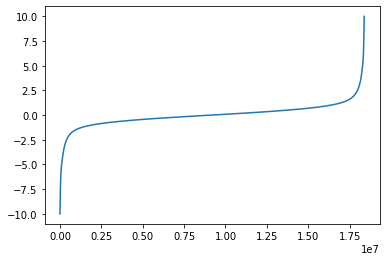

In [20]:
a = df[:][[col for col in df.columns if 'g-' in col]].values.reshape(-1,1)
plt.plot(sorted(a))

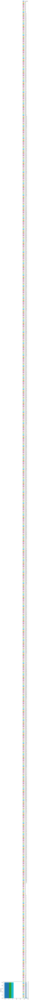

In [21]:
df[:1].plot(kind='hist')